<a href="https://colab.research.google.com/github/nikolajvester/GroupDashboard/blob/main/Copy_of_M1_airbnb_eda_geoplot_starter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Installs
!pip install pydeck -q
!pip install folium

     |████████████████████████████████| 4.3 MB 4.2 MB/s 
     |████████████████████████████████| 1.6 MB 55.2 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns #seaborn plots
from matplotlib import pyplot as plt #plot control
sns.set() #plot style

#Geoplotting with folium/leaflet
import folium
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap

#Fancy geoplotting with DeckGL
import pydeck as pdk

In [ ]:
data = pd.read_csv('http://data.insideairbnb.com/denmark/hovedstaden/copenhagen/2022-06-24/visualisations/listings.csv')

In [ ]:
data

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,6983,Copenhagen 'N Livin',16774,Simon,NaN,Nrrebro,55.686410,12.547410,Entire home/apt,877,3,171,2022-06-16,1.10,1,22,3,NaN
1,26057,Lovely house - most attractive area,109777,Kari,NaN,Indre By,55.693070,12.576490,Entire home/apt,2400,4,58,2022-05-15,0.56,1,224,8,NaN
2,26473,City Centre Townhouse Sleeps 1-10 persons,112210,Julia,NaN,Indre By,55.676020,12.575400,Entire home/apt,3350,3,293,2020-03-02,2.06,11,3,0,NaN
3,29118,Best Location in Cool Istedgade,125230,Nana,NaN,Vesterbro-Kongens Enghave,55.670230,12.555040,Entire home/apt,725,7,22,2019-08-02,0.15,1,12,0,NaN
4,32379,"165 m2 artist flat on Vesterbro, with 2 bathr...",140105,Lise,NaN,Vesterbro-Kongens Enghave,55.672638,12.552493,Entire home/apt,1153,3,76,2021-10-18,0.53,2,11,3,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12490,38610056,72m2 New apartment close to the city and water...,82892068,Abdel-Fatah,NaN,Vesterbro-Kongens Enghave,55.657300,12.561830,Entire home/apt,1057,4,41,2022-06-14,1.41,1,269,15,NaN
12491,32483807,Beautiful and modern one-bedroom apartment,244063112,Lars,NaN,Vesterbro-Kongens Enghave,55.657750,12.563190,Entire home/apt,1471,1,20,2020-06-30,0.51,1,187,0,NaN
12492,23864051,Villalejlighed Amager - praktisk og børnevenligt,179293254,Helene,NaN,Amager st,55.638690,12.618530,Entire home/apt,1200,4,10,2022-04-14,0.19,1,14,1,NaN
12493,50129088,"Luxury apartment, with perfect location in CPH",243593894,Tina,NaN,sterbro,55.696920,12.596070,Entire home/apt,2800,4,2,2022-06-21,2.00,1,172,2,NaN


In [ ]:
data = data[data.number_of_reviews > 0]

In [ ]:
data.room_type.value_counts()

Entire home/apt    8899
Private room       1255
Hotel room           22
Shared room          15
Name: room_type, dtype: int64

In [ ]:
data.room_type.unique()

array(['Entire home/apt', 'Private room', 'Shared room', 'Hotel room'],
      dtype=object)

In [ ]:
data = data[data.room_type.isin(['Private room', 'Entire home/apt'])]

In [ ]:
data.neighbourhood.value_counts()

Vesterbro-Kongens Enghave    1703
Nrrebro                      1654
Indre By                     1622
sterbro                      1070
Frederiksberg                1000
Amager Vest                   932
Amager st                     777
Bispebjerg                    493
Valby                         434
Vanlse                        265
Brnshj-Husum                  241
Name: neighbourhood, dtype: int64

In [ ]:
palette=['#FF8C00','#A034F0', '#159090']

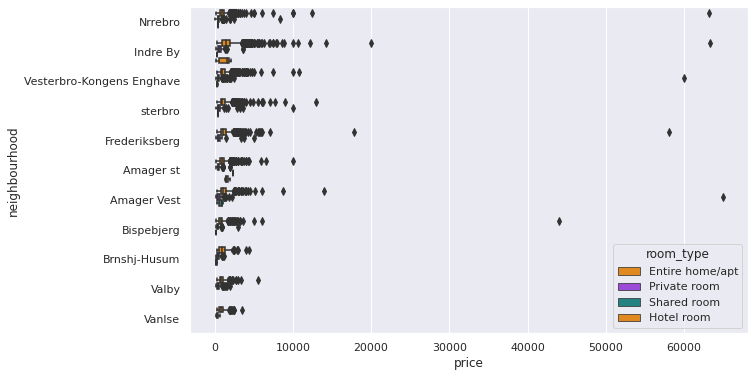

In [ ]:
plt.figure(figsize=(10,6))

sns.boxplot(data = data, x = "price", y = "neighbourhood" , 
            hue = "room_type", palette=palette)

In [ ]:
data['price_z'] = (data['price'] -data['price'].mean())/data['price'].std(ddof=0)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
data['price_z'] = data['price_z'].abs()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
data = data[data.price_z < 3]

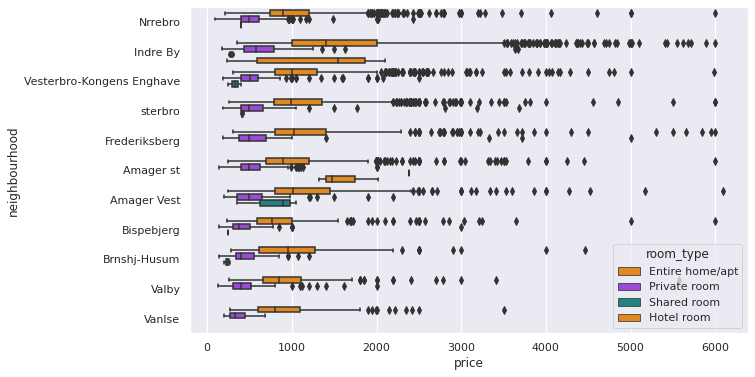

In [ ]:
plt.figure(figsize=(10,6))

sns.boxplot(data = data, x = "price", y = "neighbourhood" , 
            hue = "room_type", palette=palette)

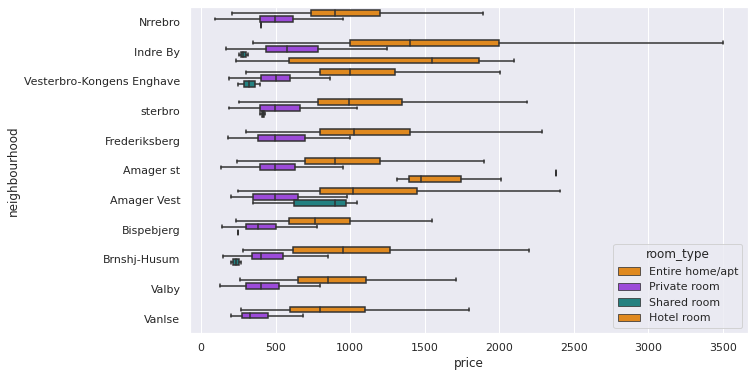

In [ ]:
plt.figure(figsize=(10,6))

sns.boxplot(data = data, x = "price", y = "neighbourhood" , 
            hue = "room_type", palette=palette, showfliers=False)

In [ ]:
data['log_price'] = np.log(data['price'])

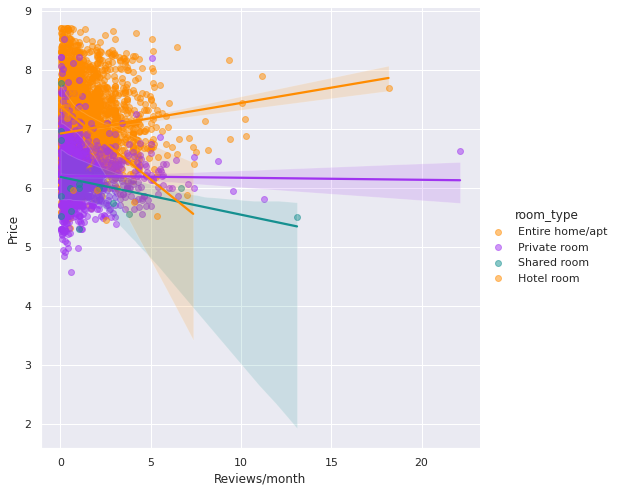

In [ ]:
g = sns.lmplot(x="reviews_per_month",
               y="log_price",
               hue="room_type",
               height=7,
               data=data,
                scatter_kws={'alpha':0.5},
               palette=palette)
g.set_xlabels('Reviews/month')
g.set_ylabels('Price')

In [ ]:
data_s = data.sample(1000)

In [ ]:
#Define the map
map = folium.Map(location=[55.7800, 12.5400], zoom_start=12)

#add prettier base-layer
folium.TileLayer('cartodbpositron').add_to(map)

#add points (in a loop)
for j in data_s.iterrows():
    marker= folium.Circle(
        radius=30,
        location=[j[1]['latitude'], j[1]['longitude']],
        tooltip=j[1]['name'],
        popup=f"<b>{j[1]['name']}</b>\n {j[1]['price']}",
        color='purple',
        fill=True
    ).add_to(map)

#locations = zip(data['longitude'], data['latitude'])
#HeatMap(locations).add_to(map)

In [ ]:
map

In [ ]:
#Define the map
map = folium.Map(location=[55.7800, 12.5400], zoom_start=12)

#add prettier base-layer
folium.TileLayer('cartodbpositron').add_to(map)

#add points (in a loop)
for j in data_s.iterrows():
    marker= folium.Circle(
        radius=30,
        location=[j[1]['latitude'], j[1]['longitude']],
        tooltip=j[1]['name'],
        popup=f"<b>{j[1]['name']}</b>\n {j[1]['price']}",
        color='purple',
        fill=True
    ).add_to(map)

locations = zip(data_s['latitude'], data_s['longitude'])
HeatMap(locations).add_to(map)

In [ ]:
map

In [ ]:
data_s = data.sample(5000)

In [ ]:
marker_cluster = MarkerCluster(
    name='CPH Airbnb',
    overlay=True,
    control=False,
    icon_create_function=None,
    showCoverageOnHover = False
)

In [ ]:
#Define the map
map = folium.Map(location=[55.7800, 12.5400], zoom_start=12)

#add prettier base-layer
folium.TileLayer('cartodbpositron').add_to(map)

#add points (in a loop)
for j in data_s.iterrows(): # <--- using the whole dataset
    marker= folium.Circle(
        radius=30,
        location=[j[1]['latitude'], j[1]['longitude']],
        tooltip=j[1]['name'],
        popup=f"<b>{j[1]['name']}</b>\n {j[1]['price']}",
        color='purple',
        fill=True
    )
    marker_cluster.add_child(marker) # <<--- here we add the marker to the cluster rather than to the map directly

marker_cluster.add_to(map)

locations = zip(data_s['latitude'], data_s['longitude'])
HeatMap(locations).add_to(map)


In [ ]:
map

In [ ]:
map.save('cph_folium.html')

In [ ]:
# Define a layer to display on a map

layer = pdk.Layer(
    "HexagonLayer",
    data,
    get_position=["longitude", "latitude"],
    auto_highlight=True,
    elevation_scale=50,
    pickable=True,
    radius=50,
    opacity=0.3,
    elevation_range=[0, 200],
    extruded=True,
    coverage=1,
)

# Set the viewport location
view_state = pdk.ViewState(latitude=data['latitude'].mean(), longitude=data['longitude'].mean(), zoom=11, min_zoom=5, max_zoom=15, pitch=40.5, bearing=-27.36)

# Render
r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip={"text": "{elevationValue}"})

In [ ]:
r.to_html(r'airbnb_hexa.html')

<IPython.core.display.Javascript object>

'<!DOCTYPE html>\n<html>\n  <head>\n    <meta http-equiv="content-type" content="text/html; charset=UTF-8" />\n    <title>pydeck</title>\n        <script src="https://api.tiles.mapbox.com/mapbox-gl-js/v1.13.0/mapbox-gl.js"></script>\n        <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0/css/bootstrap-theme.min.css" />\n    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/font-awesome/4.6.3/css/font-awesome.min.css" />\n    <script src=\'https://cdn.jsdelivr.net/npm/@deck.gl/jupyter-widget@~8.5.*/dist/index.js\'></script>\n    <style>\n    body {\n  margin: 0;\n  padding: 0;\n  overflow: hidden;\n}\n\n#deck-map-container {\n  width: 100%;\n  height: 100%;\n  background-color: black;\n}\n\n#map {\n  pointer-events: none;\n  height: 100%;\n  width: 100%;\n  position: absolute;\n  z-index: 1;\n}\n\n#deckgl-overlay {\n  z-index: 2;\n  background: none;\n}\n\n#deck-map-wrapper {\n  width: 100%;\n  height: 100%;\n}\n\n#deck-container {\n  width: 100v